# Advanced Certification Program in Computational Data Science

##  A program by IISc and TalentSprint

### Mini Project Notebook: Market Basket analysis

## Learning Objectives

At the end of the experiment, you will be able to:

* extract summary level insight from a given dataset

* Integrate the data and identify the underlying pattern or structure

* understand the fundamentals of market basket analysis

* construct "rules" that provide concrete recommendations for businesses

## Dataset

The dataset chosen for this mini project is **Instacart Dataset**. The dataset is anonymized and contains a sample of over 3 million grocery orders from more than 200,000 Instacart users. For each user, there are orders between 4 and 100, with the sequence of products purchased in each order. The dataset also includes the products in each order, the time of day and day of week of each order, the name and aisle/department of each product, which are stored across various files.

## Problem Statement


Extract association rules and find groups of frequently purchased items from a large-scale grocery orders dataset.

## Grading = 10 Points

#### Import required packages

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt
from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules

## **Stage 1**: Data Wrangling

We have five different files:

    - orders.csv
    - order_products__train.csv
    - products.csv
    - aisles.csv
    - departments.csv
	
These files contain the neccesary data to solve the problem. Load all the files correctly, after observing the header level details, data records etc
	
**Hint:** Use `read_csv` from pandas

In [3]:
# @title Download the data
!wget -qq https://cdn.iisc.talentsprint.com/CDS/Datasets/Instacart.zip
!unzip -qq Instacart.zip

replace Instacart/aisles.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
replace Instacart/departments.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
replace Instacart/orders.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
replace Instacart/order_products__train.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
replace Instacart/products.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: y


### Load the data

Load all the given datasets

In [4]:
# YOUR CODE HERE
import pandas as pd
orders=pd.read_csv("/content/Instacart/orders.csv")
products=pd.read_csv("/content/Instacart/products.csv")
departments=pd.read_csv("/content/Instacart/departments.csv")
order_products_train=pd.read_csv("/content/Instacart/order_products__train.csv")
aisles=pd.read_csv("/content/Instacart/aisles.csv")


### Data Integration (1 point)

As the required data is present in different files, we need to integrate all the five to make single dataframe/dataset. For that purpose, use the unique identifier provided in all the dataframes so that it can be used to map the data in different files correctly.

**Example:** `product_id` is available in both `products` dataframe and `order_products__train` dataframe, we can merge these two into a single dataframe based on `product_id`

**Hint:** [pd.merge](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.merge.html)

In [5]:
# YOUR CODE HERE
#Merge products and order_producs_train
print("No of rows and columns in Product catalog ",products.shape)
print("Column names in Product catalog ")
print(products.columns.values)
products.head(2)

No of rows and columns in Product catalog  (49688, 4)
Column names in Product catalog 
['product_id' 'product_name' 'aisle_id' 'department_id']


,product_id,product_name,aisle_id,department_id
0,1,Chocolate Sandwich Cookies,61,19
1,2,All-Seasons Salt,104,13


In [6]:
print("No of rows and columns in Order Products catalog",order_products_train.shape)
print("Column names in Order Products catalog ")
print(order_products_train.columns.values)
order_products_train.head(5)

No of rows and columns in Order Products catalog (1384617, 4)
Column names in Order Products catalog 
['order_id' 'product_id' 'add_to_cart_order' 'reordered']


,order_id,product_id,add_to_cart_order,reordered
0,1,49302,1,1
1,1,11109,2,1
2,1,10246,3,0
3,1,49683,4,0
4,1,43633,5,1


In [7]:
print("No of rows and columns in Orders",orders.shape)
print("Column names in Orders ")
print(orders.columns.values)
weekdict={0:"Sunday",1:"Monday",2:"Tuesday",3:"Wednesday",4:"Thursday",5:"Friday",6:"Saturday"}
orders['day_in_text']=orders.order_dow.apply(lambda x:weekdict.get(x))
orders.head(2)

No of rows and columns in Orders (3421083, 7)
Column names in Orders 
['order_id' 'user_id' 'eval_set' 'order_number' 'order_dow'
 'order_hour_of_day' 'days_since_prior_order']


,order_id,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order,day_in_text
0,2539329,1,prior,1,2,8,NaN,Tuesday
1,2398795,1,prior,2,3,7,15.0,Wednesday


In [8]:
print("No of rows and columns in Order Products catalog",aisles.shape)
print("Column names in Aisles ")
print(aisles.columns.values)
aisles.head(2)

No of rows and columns in Order Products catalog (134, 2)
Column names in Aisles 
['aisle_id' 'aisle']


,aisle_id,aisle
0,1,prepared soups salads
1,2,specialty cheeses


#Merge statement works like an inner join 
* Initial Shape of Product is 49688, 4
* Initial Shape of Orders train is 1384617, 4
* Merged data Frame has 1384617 rows and 7 columns



In [9]:
# df=products.merge(order_products_train, left_on='product_id', right_on='product_id')
df=products.merge(order_products_train, how='inner', on='product_id')
newdf = df[(df.product_id == 1) ]
newdf

,product_id,product_name,aisle_id,department_id,order_id,add_to_cart_order,reordered
0,1,Chocolate Sandwich Cookies,61,19,6695,7,1
1,1,Chocolate Sandwich Cookies,61,19,48361,9,0
2,1,Chocolate Sandwich Cookies,61,19,63770,4,0
3,1,Chocolate Sandwich Cookies,61,19,75339,9,0
4,1,Chocolate Sandwich Cookies,61,19,240996,3,1
...,...,...,...,...,...,...,...
71,1,Chocolate Sandwich Cookies,61,19,3207223,28,0
72,1,Chocolate Sandwich Cookies,61,19,3306703,1,1
73,1,Chocolate Sandwich Cookies,61,19,3357764,6,1
74,1,Chocolate Sandwich Cookies,61,19,3387572,3,0


### Understanding relationships and new insights from the data (3 points)

1.  How many times was each product ordered?

    **Hint:** group orders by product
    

2.  Find the number of orders per department and visualize using an appropriate plot


3.  On which day of the week do customers tend to buy more groceries? Which are the peak hours
of shopping? 

  * Find the frequency of orders on week days using an appropriate plot 
  * Find the frequency of orders during hours of the day using an appropriate plot?
  

4. Find the ratio of Re-ordered and Not Re-ordered products and visualize it

5. Plot the heatmap of Re-order ratio of the Day of week vs Hour of day 

How many times was each product ordered?

In [10]:
df_prod=df.set_index("product_name")
df_prod=df_prod.groupby(['product_name']).count()
df_prod=df_prod['product_id']
df_prod=df_prod.sort_values(ascending=False)
df_prod

product_name
Banana                        18726
Bag of Organic Bananas        15480
Organic Strawberries          10894
Organic Baby Spinach           9784
Large Lemon                    8135
                              ...  
Chicken Drummettes                1
Vienna Turkey Pastrami            1
Original Dry Rub                  1
Chicken Egg Roll                  1
Kids Apple Detangler Spray        1
Name: product_id, Length: 39123, dtype: int64

Find the number of orders per department and visualize using an appropriate plot

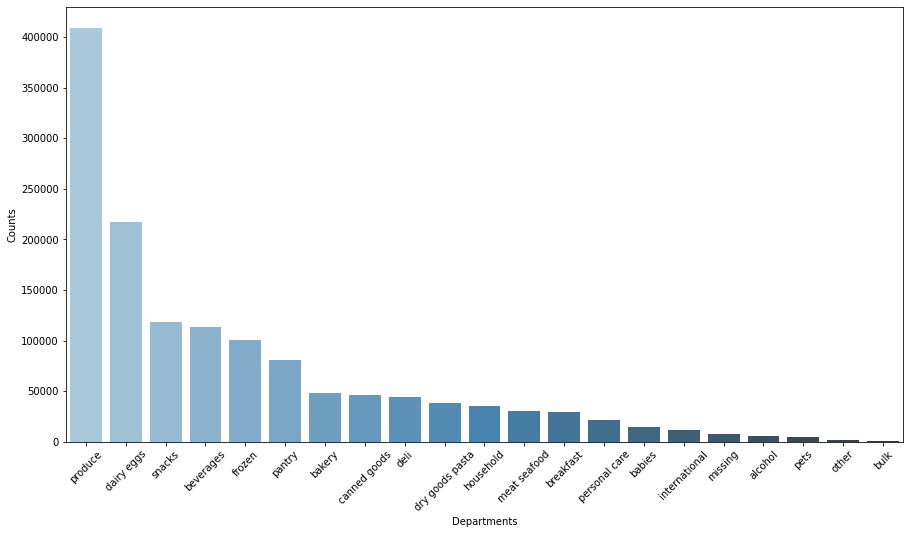

In [11]:
df_dept=df.groupby(['department_id']).count()
df_dept=df_dept.merge(departments,how="inner",on="department_id")
df_dept=df_dept.sort_values(by='order_id',ascending=False)
import seaborn as sns
from matplotlib import pyplot as plt
plt.figure(figsize=(15,8))
ax=sns.barplot(x=df_dept.department,y=df_dept.order_id,palette="Blues_d")
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
ax.set_xlabel("Departments")
ax.set_ylabel("Counts")
plt.show()



#3. On which day of the week do customers tend to buy more groceries? Which are the peak hours of shopping?
* Find the frequency of orders on week days using an appropriate plot
* Find the frequency of orders during hours of the day using an appropriate plot?


In [12]:
import plotly.express as px
print(orders.head(5))
fig = px.histogram(orders, x=orders.order_dow,hover_data=orders)
fig.show()
fig = px.histogram(orders, x=orders.order_hour_of_day,hover_data=orders)
fig.show()


   order_id  user_id  ... days_since_prior_order  day_in_text
0   2539329        1  ...                    NaN      Tuesday
1   2398795        1  ...                   15.0    Wednesday
2    473747        1  ...                   21.0    Wednesday
3   2254736        1  ...                   29.0     Thursday
4    431534        1  ...                   28.0     Thursday

[5 rows x 8 columns]


#4.Find the ratio of Re-ordered and Not Re-ordered products and visualize it

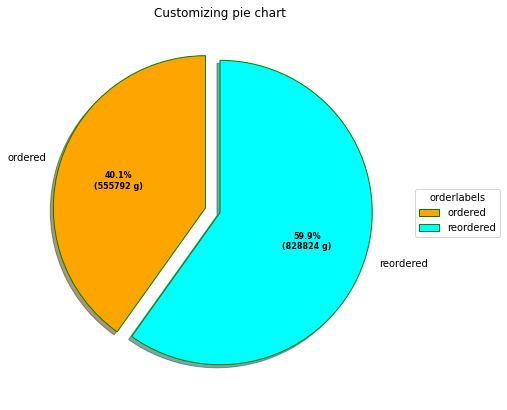

In [13]:
def func(pct, allvalues): 
    absolute = int(pct / 100.*np.sum(allvalues)) 
    return "{:.1f}%\n({:d} g)".format(pct, absolute) 

data=df.groupby('reordered').count()['order_id']
orderlabels=['ordered','reordered']
# Creating plot 
fig, ax = plt.subplots(figsize =(10, 7)) 
# Creating color parameters 
colors = ( "orange", "cyan") 
# Wedge properties 
wp = { 'linewidth' : 1, 'edgecolor' : "green" } 
# Creating explode data 
explode = (0.1, 0.0) 
wedges, texts, autotexts = ax.pie(data,  
                                  autopct = lambda pct: func(pct, data), 
                                  explode = explode,  
                                  labels = orderlabels, 
                                  shadow = True, 
                                  colors = colors, 
                                  startangle = 90, 
                                  wedgeprops = wp
) 
  
# Adding legend 
ax.legend(wedges, orderlabels, 
          title ="orderlabels", 
          loc ="center left", 
          bbox_to_anchor =(1, 0, 0.5, 1)) 
  
plt.setp(autotexts, size = 8, weight ="bold") 
ax.set_title("Customizing pie chart") 
  
# show plot 
plt.show() 

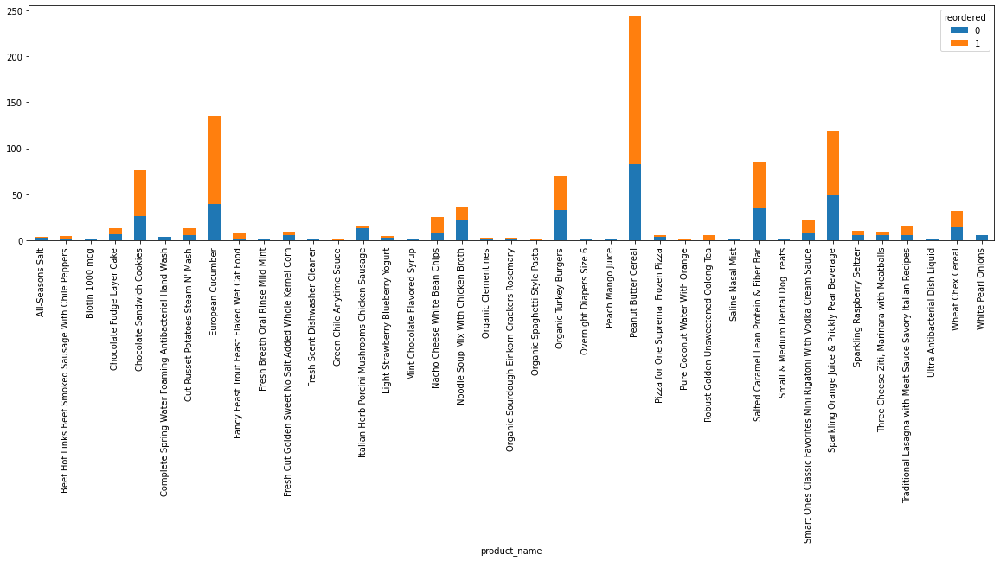

In [45]:
df_head=df.head(1000)
df2 = df_head.groupby(['product_name','reordered'])['product_name'].count().unstack('reordered').fillna(0)
df2.plot(kind='bar', stacked=True, figsize=(20, 5),)

#5.Plot the heatmap of Re-order ratio of the Day of week vs Hour of day 

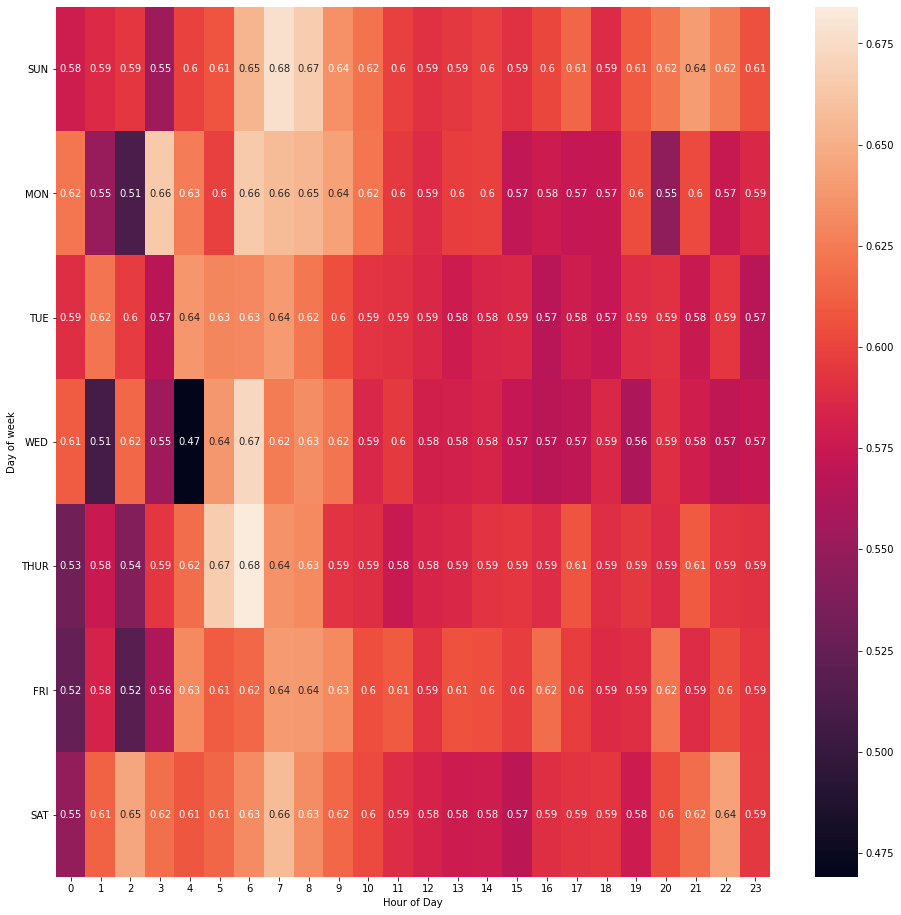

In [84]:
import seaborn as sns
#plot ratio of re-ordered/ordered
merge_orders=orders.merge(order_products_train, how='inner', on='order_id')
merge_orders=merge_orders[['order_dow','order_hour_of_day','reordered','order_id']]
merge_orders=merge_orders.groupby(['order_dow','order_hour_of_day'])['reordered'].mean().unstack()
merge_orders.head()
 
plt.figure(figsize = (16,16))
ax = sns.heatmap(merge_orders, annot=True)
ax.set_yticklabels(['SUN','MON','TUE','WED','THUR','FRI','SAT'],rotation=0)
ax.set_xlabel("Hour of Day")
ax.set_ylabel("Day of week")
plt.show()

## **Stage 2:** Create a basket (4 points)

As the dataset contains huge amount of data, let us take a subset of the data to extract the association rules from it. 

**Assumption:** Segment the data by considering the 100 most frequent ordered items. Please note it is just an assumption. You can consider 'n' frequent order items as per your choice.

**Hint:**

- Drop the unwanted columns

- Find the frequencies of orders based on the products and  consider the 100 most frequent order items.

    **Hint:** Count the frequencies of orders for each product_id using `groupby()` and `count()` respectively

- Extract the records of 100 most frequent items (which are extracted in previous step) from combined dataframe.

- Create a Pivot table with `order_id` as index and `product_name` as columns and `reorder` as values. 

    - set the `order_id` as index using set_index()
    - fill all the nan values with 0

- After performing the above step, there are a lot of zeros in the data, make sure that any positive values are converted to a 1 and anything less than 0 is set to 0.


In [16]:
# YOUR CODE HERE
#Merge all Data Frames
#Merge Products with Departments
productsDept=products.merge(departments,how="inner",on="department_id")
productsDept.head()

,product_id,product_name,aisle_id,department_id,department
0,1,Chocolate Sandwich Cookies,61,19,snacks
1,16,Mint Chocolate Flavored Syrup,103,19,snacks
2,25,Salted Caramel Lean Protein & Fiber Bar,3,19,snacks
3,32,Nacho Cheese White Bean Chips,107,19,snacks
4,41,Organic Sourdough Einkorn Crackers Rosemary,78,19,snacks


In [17]:
#Merge OrdersTrain with Orders
OTP_Order=order_products_train.merge(orders,how="inner",on="order_id")
OTP_Order

,order_id,product_id,add_to_cart_order,reordered,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order,day_in_text
0,1,49302,1,1,112108,train,4,4,10,9.0,Thursday
1,1,11109,2,1,112108,train,4,4,10,9.0,Thursday
2,1,10246,3,0,112108,train,4,4,10,9.0,Thursday
3,1,49683,4,0,112108,train,4,4,10,9.0,Thursday
4,1,43633,5,1,112108,train,4,4,10,9.0,Thursday
...,...,...,...,...,...,...,...,...,...,...,...
1384612,3421063,14233,3,1,169679,train,30,0,10,4.0,Sunday
1384613,3421063,35548,4,1,169679,train,30,0,10,4.0,Sunday
1384614,3421070,35951,1,1,139822,train,15,6,10,8.0,Saturday
1384615,3421070,16953,2,1,139822,train,15,6,10,8.0,Saturday


In [18]:
#Merge all data-Order,Product,Department with train data
OTP_Order_Product_Dept=OTP_Order.merge(productsDept,how='inner',on="product_id")
OTP_Order_Product_Dept

,order_id,product_id,add_to_cart_order,reordered,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order,day_in_text,product_name,aisle_id,department_id,department
0,1,49302,1,1,112108,train,4,4,10,9.0,Thursday,Bulgarian Yogurt,120,16,dairy eggs
1,816049,49302,7,1,47901,train,14,4,6,16.0,Thursday,Bulgarian Yogurt,120,16,dairy eggs
2,1242203,49302,1,1,2993,train,15,0,7,7.0,Sunday,Bulgarian Yogurt,120,16,dairy eggs
3,1383349,49302,11,1,41425,train,4,3,8,14.0,Wednesday,Bulgarian Yogurt,120,16,dairy eggs
4,1787378,49302,8,0,187205,train,5,4,14,30.0,Thursday,Bulgarian Yogurt,120,16,dairy eggs
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1384612,3420011,1528,12,0,177077,train,4,4,16,30.0,Thursday,Sprinkles Decors,97,13,pantry
1384613,3420084,47935,20,0,9808,train,9,6,21,30.0,Saturday,Classic Original Lip Balm SPF 12,73,11,personal care
1384614,3420084,9491,21,0,9808,train,9,6,21,30.0,Saturday,Goats Milk & Chai Soap,25,11,personal care
1384615,3420088,16380,12,0,72444,train,14,1,8,5.0,Monday,Stevia Sweetener,97,13,pantry


In [19]:
#Merge all data-Order,Product,Department with train data
OTP_Order_Product_Dept_Aisle=OTP_Order_Product_Dept.merge(aisles,how='inner',on="aisle_id")
OTP_Order_Product_Dept_Aisle

,order_id,product_id,add_to_cart_order,reordered,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order,day_in_text,product_name,aisle_id,department_id,department,aisle
0,1,49302,1,1,112108,train,4,4,10,9.0,Thursday,Bulgarian Yogurt,120,16,dairy eggs,yogurt
1,816049,49302,7,1,47901,train,14,4,6,16.0,Thursday,Bulgarian Yogurt,120,16,dairy eggs,yogurt
2,1242203,49302,1,1,2993,train,15,0,7,7.0,Sunday,Bulgarian Yogurt,120,16,dairy eggs,yogurt
3,1383349,49302,11,1,41425,train,4,3,8,14.0,Wednesday,Bulgarian Yogurt,120,16,dairy eggs,yogurt
4,1787378,49302,8,0,187205,train,5,4,14,30.0,Thursday,Bulgarian Yogurt,120,16,dairy eggs,yogurt
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1384612,2976343,45857,35,0,108139,train,5,6,10,20.0,Saturday,Pink Lemonaide Frozen Concentrate,113,1,frozen,frozen juice
1384613,2736457,4748,3,0,146402,train,7,5,10,7.0,Friday,Paradise Punch Frozen Juice Concentrate,113,1,frozen,frozen juice
1384614,2847090,8647,7,0,112812,train,5,6,13,30.0,Saturday,Apple Kiwi Strawberry Concentrate Frozen,113,1,frozen,frozen juice
1384615,3378969,8647,1,1,104694,train,34,6,16,6.0,Saturday,Apple Kiwi Strawberry Concentrate Frozen,113,1,frozen,frozen juice


In [20]:
orders_by_freq=OTP_Order_Product_Dept_Aisle['order_id'].groupby(OTP_Order_Product_Dept_Aisle.product_id).count()
orders_by_freq=pd.DataFrame(orders_by_freq)
orders_by_freq=orders_by_freq.sort_values(by=['order_id'],ascending=False)
orderreorderdf=orders_by_freq.merge(products,how='inner',on="product_id")[:5]

order_products_train_filtered=order_products_train[order_products_train['product_id'].isin(orderreorderdf.product_id)]
order_products_train_filtered=order_products_train_filtered.merge(products,how='inner',on="product_id")[["order_id","product_name","add_to_cart_order"]]
order_products_train_filtered

,order_id,product_name,add_to_cart_order
0,1,Bag of Organic Bananas,6
1,98,Bag of Organic Bananas,4
2,170,Bag of Organic Bananas,3
3,1077,Bag of Organic Bananas,1
4,1325,Bag of Organic Bananas,2
...,...,...,...
63014,3418749,Organic Baby Spinach,3
63015,3418789,Organic Baby Spinach,11
63016,3420857,Organic Baby Spinach,1
63017,3420894,Organic Baby Spinach,8


In [21]:
pivot_table=pd.pivot_table(order_products_train_filtered,index="order_id",columns="product_name",values="add_to_cart_order").fillna(0)
pivot_table

product_name,Bag of Organic Bananas,Banana,Large Lemon,Organic Baby Spinach,Organic Strawberries
order_id,,,,,
1,6.0,0.0,0.0,0.0,0.0
98,4.0,0.0,0.0,0.0,0.0
170,3.0,0.0,0.0,0.0,13.0
226,0.0,2.0,0.0,0.0,0.0
456,0.0,0.0,9.0,0.0,0.0
...,...,...,...,...,...
3420894,12.0,0.0,0.0,8.0,0.0
3420895,0.0,0.0,6.0,0.0,0.0
3420909,0.0,0.0,0.0,0.0,9.0


In [22]:
def hot_encode(x): 
    if(x<= 0): 
        return 0
    if(x>= 1): 
        return 1
pivot_table = pivot_table.applymap(hot_encode)    
pivot_table   

product_name,Bag of Organic Bananas,Banana,Large Lemon,Organic Baby Spinach,Organic Strawberries
order_id,,,,,
1,1,0,0,0,0
98,1,0,0,0,0
170,1,0,0,0,1
226,0,1,0,0,0
456,0,0,1,0,0
...,...,...,...,...,...
3420894,1,0,0,1,0
3420895,0,0,1,0,0
3420909,0,0,0,0,1


## **Stage 3:** Apply Apriori algorithm (2 points)

- As the dataset contains huge amount of data, let us take a subset of the 

---

data to extract the association rules from it.

---



  **Assumption:** Segment the basket by considering 100000 records. Please note its just an assumption, you can consider 'n'  records as per your choice.

  **Hint:** [apriori](http://rasbt.github.io/mlxtend/api_subpackages/mlxtend.frequent_patterns/)

- Find the association rules and make a dataframe

In [23]:
# YOUR CODE HERE
from mlxtend.frequent_patterns import apriori, association_rules 
# pivot_table
frq_items = apriori(pivot_table, min_support = 0.005, use_colnames = True) 

# frq_items
rules = association_rules(frq_items, metric ="support", min_threshold = 0.005) 
rules = rules.sort_values(['confidence', 'lift'], ascending =[False, False]) 
rules
# rules['Support'].unique()

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
26,"(Organic Strawberries, Organic Baby Spinach)",(Bag of Organic Bananas),0.033690,0.318198,0.012066,0.358145,1.125543,0.001346,1.062238
38,"(Organic Strawberries, Large Lemon)",(Banana),0.020905,0.384921,0.006804,0.325467,0.845543,-0.001243,0.911860
31,"(Large Lemon, Organic Baby Spinach)",(Banana),0.025448,0.384921,0.007626,0.299677,0.778542,-0.002169,0.878280
5,(Organic Strawberries),(Bag of Organic Bananas),0.223931,0.318198,0.063187,0.282174,0.886787,-0.008067,0.949815
7,(Large Lemon),(Banana),0.167218,0.384921,0.044359,0.265274,0.689164,-0.020007,0.837154
25,"(Bag of Organic Bananas, Organic Baby Spinach)",(Organic Strawberries),0.045962,0.223931,0.012066,0.262522,1.172338,0.001774,1.052329
20,"(Organic Strawberries, Large Lemon)",(Bag of Organic Bananas),0.020905,0.318198,0.005283,0.252704,0.794173,-0.001369,0.912359
19,"(Bag of Organic Bananas, Large Lemon)",(Organic Strawberries),0.021727,0.223931,0.005283,0.243141,1.085787,0.000417,1.025382
44,"(Organic Strawberries, Organic Baby Spinach)",(Banana),0.033690,0.384921,0.007729,0.229408,0.595988,-0.005239,0.798191
3,(Organic Baby Spinach),(Bag of Organic Bananas),0.201114,0.318198,0.045962,0.228536,0.718221,-0.018032,0.883778


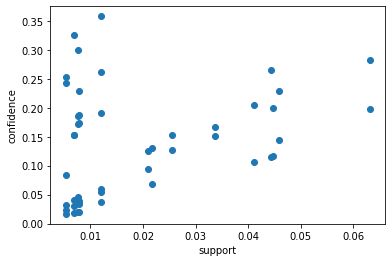

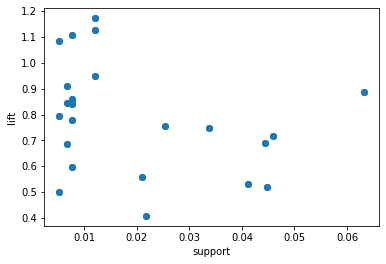

In [24]:
support=rules['support']
confidence=rules['confidence']
lift=rules['lift']

import random
import matplotlib.pyplot as plt
 
plt.scatter(support, confidence,   alpha=1, marker="o")
plt.xlabel('support')
plt.ylabel('confidence') 
plt.show()

plt.scatter(support, lift,   alpha=1, marker="o")
plt.xlabel('support')
plt.ylabel('lift') 
plt.show()

antecedents    (Organic Strawberries, Organic Baby Spinach)
consequents                        (Bag of Organic Bananas)
Name: 26, dtype: object
antecedents    (Organic Strawberries, Large Lemon)
consequents                               (Banana)
Name: 38, dtype: object
antecedents    (Large Lemon, Organic Baby Spinach)
consequents                               (Banana)
Name: 31, dtype: object
antecedents      (Organic Strawberries)
consequents    (Bag of Organic Bananas)
Name: 5, dtype: object
antecedents    (Large Lemon)
consequents         (Banana)
Name: 7, dtype: object
antecedents    (Bag of Organic Bananas, Organic Baby Spinach)
consequents                            (Organic Strawberries)
Name: 25, dtype: object
antecedents    (Organic Strawberries, Large Lemon)
consequents               (Bag of Organic Bananas)
Name: 20, dtype: object


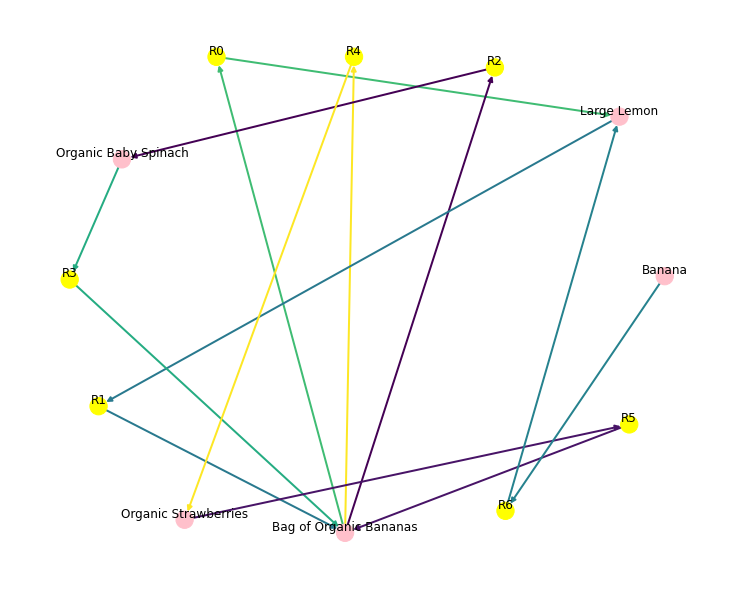

In [25]:
def draw_graph(rules, rules_to_show):
  import networkx as nx  
  G1 = nx.DiGraph()
   
  color_map=[]
  N = 50
  colors = np.random.rand(N)    
  strs=['R0', 'R1', 'R2', 'R3', 'R4', 'R5', 'R6', 'R7', 'R8', 'R9', 'R10', 'R11']   
   
  plt.figure(3,figsize=(10,8))  
  for i in range (rules_to_show):      
    G1.add_nodes_from(["R"+str(i)])
    print(rules.iloc[i][['antecedents','consequents']])   
     
    for a in rules.antecedents[i]:                
        G1.add_nodes_from([a])        
        G1.add_edge(a, "R"+str(i), color=colors[i] , weight = 2)
       
    for c in rules.consequents[i]:             
            # G1.add_nodes_from(c)            
            G1.add_edge("R"+str(i), c, color=colors[i],  weight=2)
 
  for node in G1:
       found_a_string = False
       for item in strs: 
           if node==item:
                found_a_string = True
       if found_a_string:
            color_map.append('yellow')
       else:
            color_map.append('pink')       
 
 
   
  edges = G1.edges()
  colors = [G1[u][v]['color'] for u,v in edges]
  weights = [G1[u][v]['weight'] for u,v in edges]
  pos = nx.spring_layout(G1, k=5, scale=4)
  nx.edges=edges
  nx.draw(G1,pos,node_color = color_map,edge_color=colors,width=weights, font_size=14, with_labels=False)
   
  for p in pos:  # raise text positions
           pos[p][1] += 0.09
         
  nx.draw_networkx_labels(G1, pos)
  plt.show()
draw_graph (rules, 7)    